# Brain Stroke Dataset - Analysis, Part III

**Author:** Jakub Bednarz

**Previous parts**: [Part I](https://github.com/mim-uw/eXplainableMachineLearning-2023/blob/main/Homeworks/HW1/JakubBednarz/Analysis.ipynb), [Part II](https://htmlpreview.github.io/?https://github.com/mim-uw/eXplainableMachineLearning-2023/blob/main/Homeworks/HW2/JakubBednarz/Analysis%2C%20Part%20II.html).

In [81]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
from typing import Union
import plotly.offline as py
import plotly.io as pio
from scipy.special import logit
from copy import deepcopy
import warnings
warnings.filterwarnings(action="ignore")
pio.renderers.default = "notebook"

from sklearn.preprocessing import OneHotEncoder, OrdinalEncoder
from sklearn.pipeline import Pipeline
from sklearn.compose import ColumnTransformer
from sklearn.model_selection import train_test_split
from sklearn.model_selection import cross_val_score, StratifiedKFold
from sklearn.base import BaseEstimator, ClassifierMixin
from xgboost.sklearn import XGBClassifier
from sklearn.linear_model import LogisticRegressionCV, LogisticRegression
from sklearn.metrics import roc_auc_score
from sklearn.utils.class_weight import compute_sample_weight

import optuna
from optuna.trial import Trial, FrozenTrial
from optuna.integration.sklearn import OptunaSearchCV

import shap
import shap.maskers
import dalex
import lime

In [82]:
df = pd.read_csv("brain_stroke.csv")
for col in ("hypertension", "heart_disease"):
    df[col] = df[col].apply(lambda idx: ["No", "Yes"][idx])

In [83]:
# for name, values in df.select_dtypes("object").iteritems():
#     print(name, values.unique())

In [84]:
class ColumnTransformerEx(ColumnTransformer):
    def transform(self, X):
        if isinstance(X, pd.DataFrame):
            return pd.DataFrame(
                data=np.asarray(super().transform(X)),
                columns=self.get_feature_names_out(),
                index=X.index,
            )
        else:
            return super().transform(X)
    
    def fit_transform(self, X, y=None):
        if isinstance(X, pd.DataFrame):
            return pd.DataFrame(
                data=np.asarray(super().fit_transform(X, y)),
                columns=self.get_feature_names_out(),
                index=X.index,
            )
        else:
            return super().fit_transform(X, y)

cat_features = [
    "gender",
    "ever_married",
    "work_type",
    "Residence_type",
    "smoking_status",
    "hypertension",
    "heart_disease",
]

one_tf = ColumnTransformerEx(
    transformers=[
        (col, OneHotEncoder(drop="if_binary"), [col])
        for col in cat_features],
    remainder="passthrough",
    verbose_feature_names_out=False,
)

ord_tf = ColumnTransformerEx(
    transformers=[
        (col, OrdinalEncoder(), [col])
        for col in cat_features],
    remainder="passthrough",
    verbose_feature_names_out=False,
)

one_df = one_tf.fit_transform(df)
ord_df = ord_tf.fit_transform(df)

all_features = ord_df.columns.tolist()

cat_idxes = [all_features.index(feat) for feat in cat_features]

cat_names = {
    idx: OrdinalEncoder().fit(df[[feat]]).categories_[0]
    for idx, feat in zip(cat_idxes, cat_features)
}

In [85]:
def split(df):
    X, y = df.drop(columns=["stroke"]), df["stroke"]
    train_X, test_X, train_y, test_y = \
        train_test_split(X, y, test_size=0.2, random_state=42, stratify=y)
    return train_X, test_X, train_y, test_y

train_X, test_X, train_y, test_y = split(df)
train_X_one, test_X_one, train_y_one, test_y_one = split(one_df)
train_X_ord, test_X_ord, train_y_ord, test_y_ord = split(ord_df)

In [86]:
conv_tf = ColumnTransformer(
    transformers=[
        (col, OneHotEncoder(drop="if_binary"), [idx])
        for col, idx in zip(cat_features, cat_idxes)],
    remainder="passthrough",
    verbose_feature_names_out=False,
)

conv_tf = conv_tf.fit(ord_df.drop(columns=["stroke"]).to_numpy())

In [87]:
class OptunaTrainer:
    def fit(self, X, y):
        def model_fn(trial: Union[Trial, FrozenTrial]):
            return XGBClassifier(
                max_depth=int(trial.suggest_float("max_depth", 3, 18, step=1)),
                gamma=trial.suggest_float("gamma", 1, 9),
                reg_alpha=int(trial.suggest_float("reg_alpha", 40, 180, step=1)),
                reg_lambda=trial.suggest_float("reg_lambda", 0, 1),
                colsample_bytree=trial.suggest_float("colsample_bytree", 0.5, 1),
                min_child_weight=int(trial.suggest_float("min_child_weight", 0, 10, step=1)),
                n_estimators=180,
                seed=42,
            )

        sample_wt = compute_sample_weight(
            class_weight="balanced",
            y=y,
        )
        
        fit_params = dict(
            sample_weight=sample_wt,
        )

        def objective(trial: optuna.Trial):
            model = model_fn(trial)
            return np.min(cross_val_score(model, X, y, scoring="roc_auc", fit_params=fit_params))
        
        optuna.logging.set_verbosity(optuna.logging.WARN)
        sampler = optuna.samplers.TPESampler(seed=99)
        study = optuna.create_study(direction="maximize", sampler=sampler)
        study.optimize(objective, n_trials=16)

        model = model_fn(study.best_trial)
        model.fit(X, y, **fit_params)
        return model

xgb_model = OptunaTrainer().fit(train_X_one, train_y_one)

In [88]:
# roc_auc_score(test_y, xgb_model.predict(test_X))

In [89]:
lr_model_cv = LogisticRegressionCV(
    solver="liblinear",
    scoring="roc_auc",
    class_weight="balanced",
)

lr_model_cv = lr_model_cv.fit(train_X_one, train_y_one)

lr_model = LogisticRegression(
    solver="liblinear",
    class_weight="balanced",
    C=lr_model_cv.C_[0],
)

lr_model = lr_model.fit(train_X_one, train_y_one)

## Introduction
Previously, we have attempted to explain the decisions our predictive models take with SHAP values. In this report, we will approach the same task with a different method - *Local Interpretable Model-agnostic Explanations* (LIME). To be specific, we will:

1. Understand how LIME operates;
2. See it "in action" by explaining selected predictions using it;
3. Compare its predictions with those obtained by SHAP;
4. Check how the explanations differ across different classes of models.

## LIME explained
*Local Interpretable Model-agnostic Explanations* aims to provide explanations for observations by training *local surrogate models* - simpler, interpretable models which are fitted to approximate the behavior of the black-box model in the vicinity of a given observation. To give an analogy, this is similar to how one can approximate a manifold at a point with the tangent space. Specifically, LIME:
- first, transforms the data instances into an interpretable feature space;
- approximates the black-box model at a point/observation with a local surrogate model (usually a linear model) - the fitting of this surrogate model is done on artificial points obtained by perturbing the original observation.

Mathematically, we may rephrase it as $$\hat{g} = \text{arg min}_{g \in G} L(f, g, \pi(x)) + \Omega(g)$$ where $G$ denotes the class of surrogate models (for example, decision trees or linear regression models), $L$ is a loss function which measures the discrepancy between the black-box $f$ and $g$ in the neighborhood $\pi(x)$, and $\Omega(g)$ denotes the penalty for the complexity of $g$ (for example, decision tree depth or the sparsity of a linear model.)

## LIME explanations for the brain stroke dataset
Let's now compute some explanations. We shall use the [`lime`](https://github.com/marcotcr/lime) Python package.

To get a feel for what kind of explanations LIME provides, let's start with a single observation.

In [90]:
gen = np.random.default_rng(seed=0)
idxes = gen.choice(len(test_X), size=2)
obs = test_X.iloc[idxes]
pd.concat([test_X, test_y], axis="columns").iloc[idxes].T

,4379,2473
gender,Male,Male
age,31.0,66.0
hypertension,No,Yes
heart_disease,No,No
ever_married,No,Yes
work_type,Self-employed,Private
Residence_type,Rural,Urban
avg_glucose_level,64.85,82.91
bmi,23.0,28.9
smoking_status,Unknown,formerly smoked


Before we continue, we must remark on a certain aspect of LIME - it is important to choose an appropriate interpretable feature space for the data points. For example, when dealing with images, it would be unhelpful to get some kind of feature importance for the value of a single pixel in an image - we would far rather be interested in more high-level features, such as an object of a given class being present in the image, or having some property (say, being red or being oriented in a particular fashion). Because we are dealing with tabular data, however, and further taking into account what the columns are, it seems unnecessary to further refine the features, as they are already sufficiently high-level and interpretable. 

With that clarified, let us look at the output of the `lime` package:

In [91]:
from lime.lime_tabular import LimeTabularExplainer

lime_expl = LimeTabularExplainer(
    training_data=train_X_ord.to_numpy(),
    feature_names=train_X_ord.columns,
    mode="classification",
    categorical_features=cat_idxes,
    categorical_names=cat_names,
    random_state=42,
)

In [92]:
exp = lime_expl.explain_instance(
    data_row=test_X_ord.iloc[idxes[0]].to_numpy(),
    predict_fn=lambda r: xgb_model.predict_proba(conv_tf.transform(r)),
)
exp.show_in_notebook()

What we are looking at are:
- on the left, the output of the tree model, i.e. predicted probabilities for not having (0) or having (1) a brain stroke;
- in the middle, the contributions from each variable (note that `lime` discretizes continuous variables by default), or, to be more specific, the coefficients for the most important features in the local linear model trained on points in the vicinity of the selected observation, with the target being the probability measure;
- on the right, the original values of the variables (that is, before discretization.)

Let us now comment on the results themselves, and how to interpret them. The predicted probability of having a stroke is low (12%), and according to the local model the most significant factor in it being low is the value of `age` being between 26 and 45 - to be specific, it reduces the probability from the baseline by 22 percentage points; the next one, subject not being ever married, reduces it by 8 percentage points; them not having hypertension reduces it by 6 percentage points, etc.

Let's look at a different example:

In [93]:
exp = lime_expl.explain_instance(
    data_row=test_X_ord.iloc[idxes[1]].to_numpy(),
    predict_fn=lambda r: xgb_model.predict_proba(conv_tf.transform(r)),
)
exp.show_in_notebook()

Here, the situtation is diametrically different - the predicted probability is 60%, with age being over 61 contributing 40 percentage points to the local surrogate's prediction, being ever married adding 7 percentage points etc.

### Study of randomness of LIME

One interesting thing about LIME is that, because we sample points in the vicinity of the observation, its explanations inherently depend on the random seed. Thus, a question arises - to what extent are the explanations different as the seed differs? Let's investigate it:
- for seed `0`:

In [94]:
lime_expl_0 = LimeTabularExplainer(
    training_data=train_X_ord.to_numpy(),
    feature_names=train_X_ord.columns,
    mode="classification",
    categorical_features=cat_idxes,
    categorical_names=cat_names,
    random_state=0,
)
exp = lime_expl.explain_instance(
    data_row=test_X_ord.iloc[idxes[0]].to_numpy(),
    predict_fn=lambda r: xgb_model.predict_proba(conv_tf.transform(r)),
)
exp.show_in_notebook()

- for seed `1`:

In [95]:
lime_expl_1 = LimeTabularExplainer(
    training_data=train_X_ord.to_numpy(),
    feature_names=train_X_ord.columns,
    mode="classification",
    categorical_features=cat_idxes,
    categorical_names=cat_names,
    random_state=1,
)
exp = lime_expl_1.explain_instance(
    data_row=test_X_ord.iloc[idxes[0]].to_numpy(),
    predict_fn=lambda r: xgb_model.predict_proba(conv_tf.transform(r)),
)
exp.show_in_notebook()

- for seed `99`:

In [96]:
lime_expl_99 = LimeTabularExplainer(
    training_data=train_X_ord.to_numpy(),
    feature_names=train_X_ord.columns,
    mode="classification",
    categorical_features=cat_idxes,
    categorical_names=cat_names,
    random_state=99,
)
exp = lime_expl_99.explain_instance(
    data_row=test_X_ord.iloc[idxes[0]].to_numpy(),
    predict_fn=lambda r: xgb_model.predict_proba(conv_tf.transform(r)),
)
exp.show_in_notebook()

We can see that the explanations differ ever so slightly - to point out some of the differences, sometimes the ranks of `hypertension=No` and `ever_married=No` are swapped, likewise with glucose levels and BMI values. Whether that's an issue depends on the application, I would say.

### Comparison with SHAP
Having now two methods in our arsenal, let's see whether (and if, how) the explanations they offer differ.

We will perform the investigation on the following data point:

In [97]:
gen = np.random.default_rng(seed=81)
idxes = gen.choice(len(test_X), size=2)[[1]]
obs = test_X.iloc[idxes]
pd.concat([test_X, test_y], axis="columns").iloc[idxes].T

,1071
gender,Female
age,49.0
hypertension,No
heart_disease,No
ever_married,Yes
work_type,Private
Residence_type,Urban
avg_glucose_level,67.55
bmi,17.6
smoking_status,formerly smoked


For them, `lime` yields a following explanation:

In [98]:
exp = lime_expl.explain_instance(
    data_row=test_X_ord.iloc[idxes[0]].to_numpy(),
    predict_fn=lambda r: xgb_model.predict_proba(conv_tf.transform(r)),
)
exp.show_in_notebook()

whereas `shap` outputs the following:

In [99]:
xgb_expl_shap = shap.TreeExplainer(
    xgb_model,
    data=test_X_one,
    model_output="probability",
)

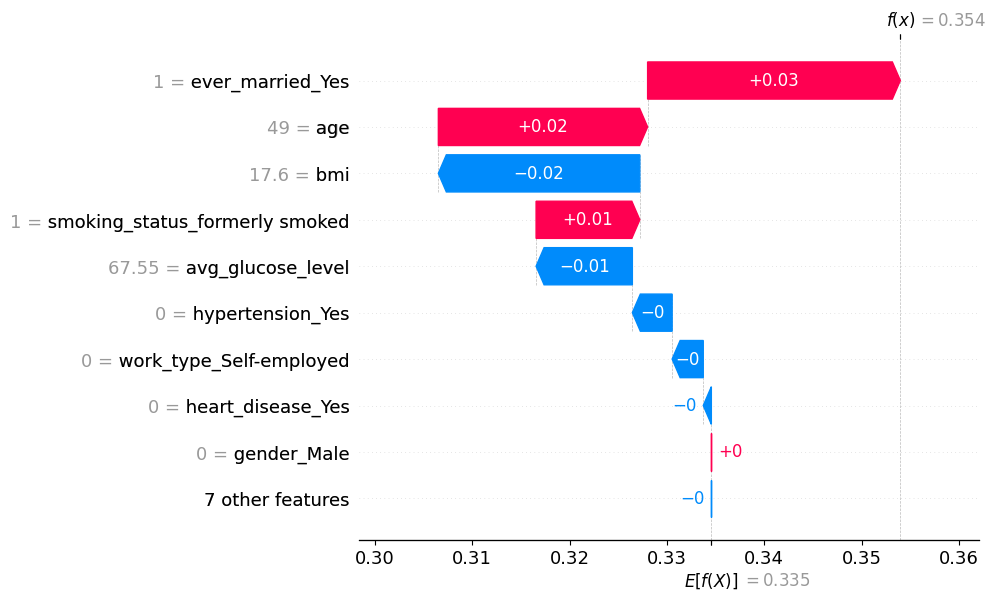

In [100]:
shap.plots.waterfall(xgb_expl_shap(test_X_one.iloc[idxes])[0])

We can see that the results are fairly similar, but different - for example, SHAP attributes less to the lack of hypertension than LIME. Let's look at another example, just to check if this pattern holds:

In [101]:
gen = np.random.default_rng(seed=54)
idxes = gen.choice(len(test_X), size=1)
obs = test_X.iloc[idxes]
pd.concat([test_X, test_y], axis="columns").iloc[idxes].T

,1811
gender,Female
age,5.0
hypertension,No
heart_disease,No
ever_married,No
work_type,children
Residence_type,Rural
avg_glucose_level,109.4
bmi,20.0
smoking_status,Unknown


In [102]:
exp = lime_expl.explain_instance(
    data_row=test_X_ord.iloc[idxes[0]].to_numpy(),
    predict_fn=lambda r: xgb_model.predict_proba(conv_tf.transform(r)),
)
exp.show_in_notebook()

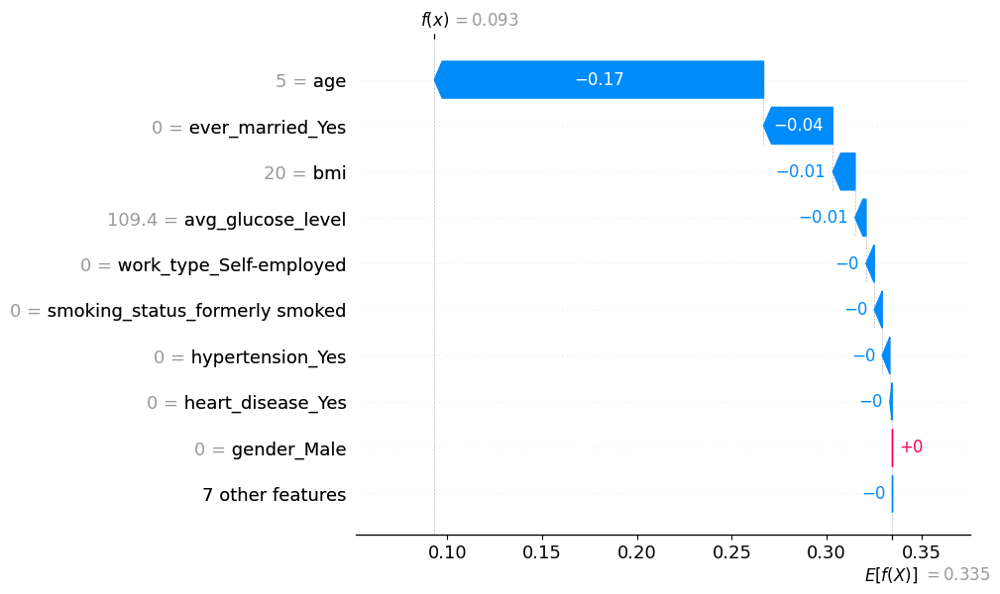

In [103]:
shap.plots.waterfall(xgb_expl_shap(test_X_one.iloc[idxes])[0])

It would seem (from the admittedly atrociously small sample of *two*) that there exist some definite differences between the explanations offered by SHAP and LIME.

### LIME on logistic regression
As for SHAP, we will now look at what the explanations look like for the logistic regression model, and how they differ from the ones for the XGBoost. In this case, it's particularly interesting to see what it will look like, since a local linear approximation to a linear model is, well, the same model, with the caveat that logistic regression is linear in the log-odds, and not probabilities.

In [104]:
gen = np.random.default_rng(seed=24)
idxes = gen.choice(len(test_X), size=4)
obs = test_X.iloc[idxes]
pd.concat([test_X, test_y], axis="columns").iloc[idxes].T

,4598,2204,2843,1277
gender,Male,Female,Female,Male
age,54.0,29.0,24.0,12.0
hypertension,No,No,No,No
heart_disease,No,No,No,No
ever_married,Yes,No,No,No
work_type,Govt_job,Private,Private,children
Residence_type,Urban,Rural,Urban,Rural
avg_glucose_level,72.96,86.55,149.17,81.74
bmi,37.7,29.8,23.1,28.3
smoking_status,smokes,smokes,never smoked,Unknown


In [105]:
exp = lime_expl.explain_instance(
    data_row=test_X_ord.iloc[idxes[0]].to_numpy(),
    predict_fn=lambda r: lr_model.predict_proba(conv_tf.transform(r)),
)
exp.show_in_notebook()

In [106]:
exp = lime_expl.explain_instance(
    data_row=test_X_ord.iloc[idxes[1]].to_numpy(),
    predict_fn=lambda r: lr_model.predict_proba(conv_tf.transform(r)),
)
exp.show_in_notebook()

In [107]:
exp = lime_expl.explain_instance(
    data_row=test_X_ord.iloc[idxes[2]].to_numpy(),
    predict_fn=lambda r: lr_model.predict_proba(conv_tf.transform(r)),
)
exp.show_in_notebook()

In [108]:
exp = lime_expl.explain_instance(
    data_row=test_X_ord.iloc[idxes[3]].to_numpy(),
    predict_fn=lambda r: lr_model.predict_proba(conv_tf.transform(r)),
)
exp.show_in_notebook()

In my estimation, "for the most part" the features indicated to be most significant are the same as for the XGBoost model. One difference I've noticed is that the logistic regression seems to put far more stock into different work types - in contrast, for the tree model, it was virtually always negligible.

Now, let's look at the aforementioned "local approx of linear model is linear" hypothesis. One way to check it would be to see if, when trying to explain logits of the probabilities returned by the logistic regression model, we get the same attributions (read: coefficients) for different observations. When doing just that for four previous data points, we get:

In [109]:
lime_log_expl = LimeTabularExplainer(
    training_data=train_X_ord.to_numpy(),
    feature_names=train_X_ord.columns,
    mode="regression",
    categorical_features=cat_idxes,
    categorical_names=cat_names,
    random_state=42,
)

In [110]:
exp = lime_log_expl.explain_instance(
    data_row=test_X_ord.iloc[idxes[0]].to_numpy(),
    predict_fn=lambda r: logit(lr_model.predict_proba(conv_tf.transform(r))),
)
exp.show_in_notebook()

In [111]:
exp = lime_log_expl.explain_instance(
    data_row=test_X_ord.iloc[idxes[1]].to_numpy(),
    predict_fn=lambda r: logit(lr_model.predict_proba(conv_tf.transform(r))),
)
exp.show_in_notebook()

In [112]:
exp = lime_log_expl.explain_instance(
    data_row=test_X_ord.iloc[idxes[2]].to_numpy(),
    predict_fn=lambda r: logit(lr_model.predict_proba(conv_tf.transform(r))),
)
exp.show_in_notebook()

In [113]:
exp = lime_log_expl.explain_instance(
    data_row=test_X_ord.iloc[idxes[3]].to_numpy(),
    predict_fn=lambda r: logit(lr_model.predict_proba(conv_tf.transform(r))),
)
exp.show_in_notebook()

The contributions for the same (possibly discretized) features are *not* the same. One can then wonder what could be the reason behind this - I surmise it's possible that the different data points used to fit the model, as well as the complexity penalty, could play a role in this discrepancy, though I cannot say for sure.